Run with IRKernel or Rstudio
- install following packages if you need

In [43]:
# install.packages("tidyverse")
# install.packages("vcfR")
# install.packages("circlize")
# BiocManager::install("VariantAnnotation")
# BiocManager::install("maftools")
# BiocManager::install("GenVisR")
# BiocManager::install("karyoploteR")
# BiocManager::install("ggbio")
# BiocManager::install("MutationalPatterns")
# BiocManager::install("BSgenome.Hsapiens.UCSC.hg38")
suppressPackageStartupMessages({
  library(tidyverse)
  library(VariantAnnotation)
  library(maftools)
  library(GenVisR)
  library(karyoploteR)
  library(ggbio)
  library(vcfR)
  library(MutationalPatterns)
  library(circlize)
  library(BSgenome.Hsapiens.UCSC.hg38)
})

#### 1. Get basic statistics from `vcf` files

In [13]:
data <- read.vcfR('out/Tumor_filtered.vcf')
glimpse(data)

Scanning file to determine attributes.
File attributes:
  meta lines: 524
  header_line: 525
  variant count: 21355
  column count: 11


Meta line 524 read in.
All meta lines processed.
gt matrix initialized.
Character matrix gt created.
  Character matrix gt rows: 21355
  Character matrix gt cols: 11
  skip: 0
  nrows: 21355
  row_num: 0
Processed variant: 21355
All variants processed
Formal class 'vcfR' [package "vcfR"] with 3 slots
  ..@ meta: chr [1:524] "##fileformat=VCFv4.2" "##FILTER=<ID=FAIL,Description=\"Fail the site if all alleles fail but for different reasons.\">" "##FILTER=<ID=PASS,Description=\"Site contains at least one allele that passes filters\">" "##FILTER=<ID=base_qual,Description=\"alt median base quality\">" ...
  ..@ fix : chr [1:21355, 1:8] "chr1" "chr1" "chr1" "chr1" ...
  .. ..- attr(*, "dimnames")=List of 2
  ..@ gt  : chr [1:21355, 1:3] "GT:AD:AF:DP:F1R2:F2R1:FAD:PGT:PID:PS:SB" "GT:AD:AF:DP:F1R2:F2R1:FAD:PGT:PID:PS:SB" "GT:AD:AF:DP:F1R2:F2R1:FAD:PGT:PID:PS:SB" "GT:AD:AF:DP:F1R2:F2R1:FAD:PGT:PID:PS:SB" ...
  .. ..- attr(*, "dimnames")=List of 2


In [25]:
gt_df <- as.data.frame(data@gt) |> 
  separate(col = Tumor, into = c("GT", "AD", "AF", "DP", "F1R2", "F2R1", "FAD", "PGT", "PID", "PS", "SB"), sep = ":") 

gt_df <- gt_df |>
  mutate(AF = as.numeric(AF), DP = as.numeric(DP))

summary(gt_df$AF)
summary(gt_df$DP)

Warning message:
"Expected 11 pieces. Missing pieces filled with `NA` in 15428 rows [5, 6, 7, 8, 9, 10, 13, 14, 15, 16, 17, 18, 19, 20,
21, 22, 23, 24, 25, 26, ...]."
Warning message:
"There was 1 warning in `mutate()`.
ℹ In argument: `AF = as.numeric(AF)`.
Caused by warning:
! NAs introduced by coercion"


   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
 0.0021  0.1920  0.3330  0.3421  0.5000  0.9120     735 

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
   0.00    3.00    6.00   57.37   29.00 4407.00 

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
Warning message:
"Removed 735 rows containing non-finite outside the scale range (`stat_bin()`)."
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


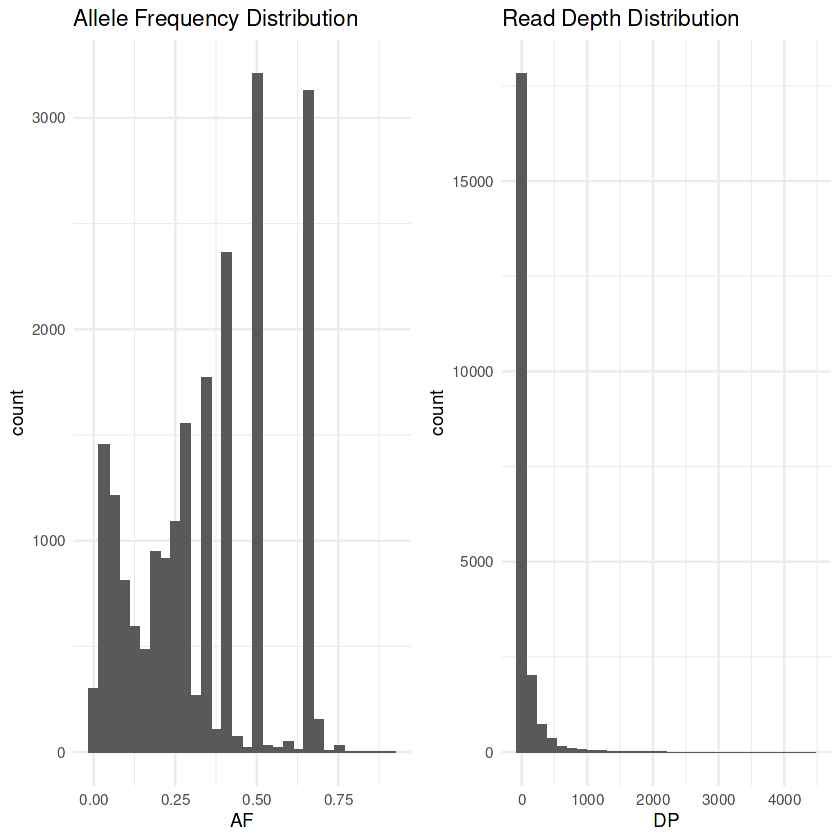

In [32]:
p1 <- ggplot(gt_df, aes(x = AF)) + 
  geom_histogram() + 
  labs(title = "Allele Frequency Distribution") + 
  theme_minimal()

p2 <- ggplot(gt_df, aes(x = DP)) + 
  geom_histogram() + 
  labs(title = "Read Depth Distribution") +
  theme_minimal()

gridExtra::grid.arrange(p1, p2, ncol = 2)

### 2. Check variant distribution

In [47]:
fix_df <- as.data.frame(data@fix)
gr <- GRanges(
  seqnames = Rle(fix_df$CHROM),
  ranges = IRanges(
    start = as.numeric(fix_df$POS),
    end = as.numeric(fix_df$POS)
  ),
  ref = fix_df$REF,
  alt = fix_df$ALT
)
GenomeInfoDb::genome(gr) = 'hg38'
gr_filtered <- gr[seqnames(gr) %in% "chr5"]

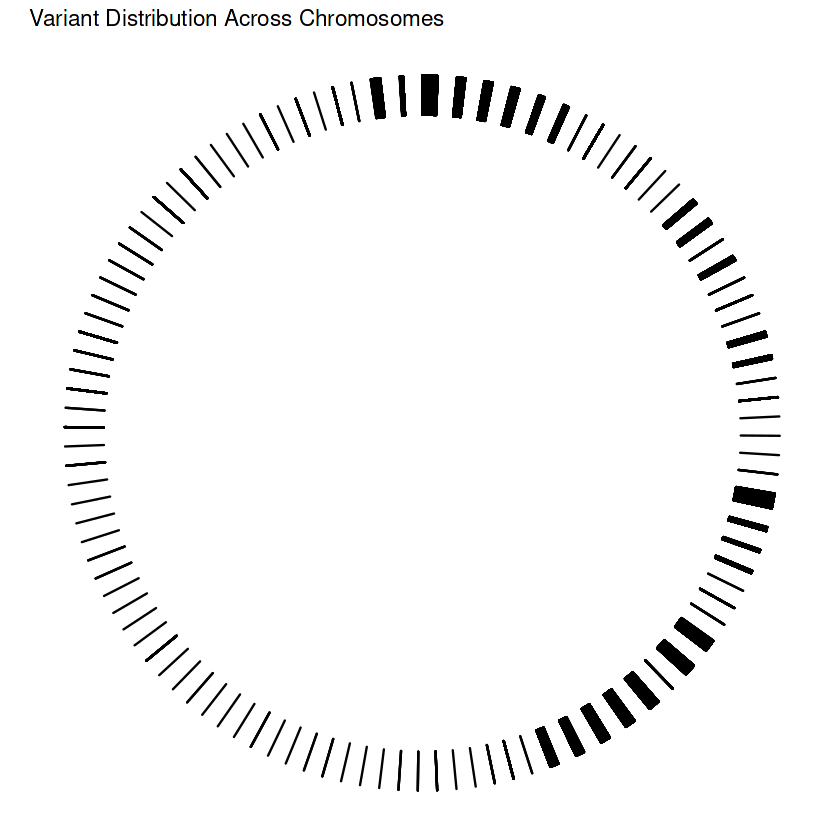

In [40]:
autoplot(gr, layout = "circle") +
  labs(title = "Variant Distribution Across Chromosomes")

Warning message in getIdeoGR(data):
"geom(ideogram) need valid seqlengths information for accurate mapping,
                 now use reduced information as ideogram... "
Warning message in getIdeoGR(data):
"geom(ideogram) need valid seqlengths information for accurate mapping,
                 now use reduced information as ideogram... "
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.
Scale for x is already present.
Adding another scale for x, which will replace the existing scale.


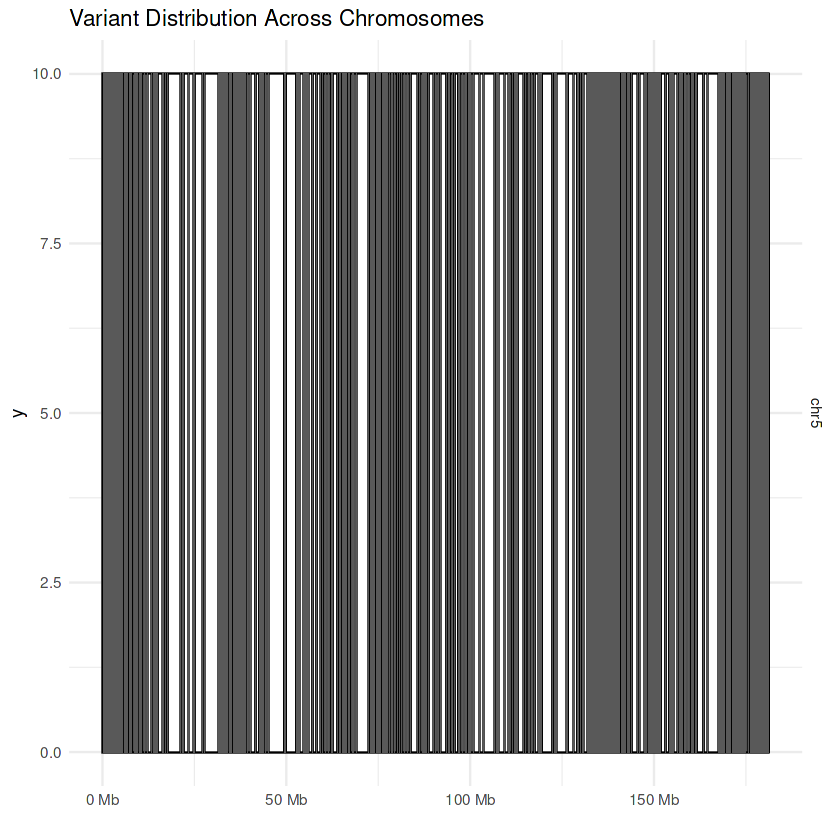

In [37]:
autoplot(gr_filtered, layout = "karyogram") +
  labs(title = "Variant Distribution Across Chromosomes") +
  theme_minimal()

### 3. Check mutational signature

In [48]:
mut_mat <- mut_matrix(vcf_list = list(gr), ref_genome = BSgenome.Hsapiens.UCSC.hg38)
plot_96_profile(mut_mat) +
  labs(title = "96 Mutation Signature Profile")

ERROR: Error: There seem to be at least 2219 Indels present in your data. Make sure to remove all Indels with the `get_mut_type` function.


In [ ]:
signatures <- get_known_signatures()

# Fit the mutation profile to known signatures
fit_res <- fit_to_signatures(mut_mat, signatures)

# Plot the fitting results
plot_contribution(fit_res$contribution, signatures, coord_flip = TRUE) +
  labs(title = "Mutation Signature Contribution")

### 4. Oncoplots

In [50]:
maf <- read_vcf_as_maf('out/Tumor_filtered.vcf', ref_genome = BSgenome.Hsapiens.UCSC.hg38)

ERROR: Error in read_vcf_as_maf("out/Tumor_filtered.vcf", ref_genome = BSgenome.Hsapiens.UCSC.hg38): could not find function "read_vcf_as_maf"


### 5. Circos Plot

### 6. Depth & Quality Plot

In [49]:
ggplot(data@fix, aes(x = DP)) + geom_histogram() + labs(title = "Read Depth Distribution")

ERROR while rich displaying an object: Error in `geom_histogram()`:
! Problem while computing aesthetics.
ℹ Error occurred in the 1st layer.
Caused by error:
! object 'DP' not found

Traceback:
1. sapply(x, f, simplify = simplify)
2. lapply(X = X, FUN = FUN, ...)
3. FUN(X[[i]], ...)
4. tryCatch(withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .         return(NULL)
 .     prepare_content(is.raw(rpr), rpr)
 . }, error = error_handler), error = outer_handler)
5. tryCatchList(expr, classes, parentenv, handlers)
6. tryCatchOne(expr, names, parentenv, handlers[[1L]])
7. doTryCatch(return(expr), name, parentenv, handler)
8. withCallingHandlers({
 .     if (!mime %in% names(repr::mime2repr)) 
 .         stop("No repr_* for mimetype ", mime, " in repr::mime2repr")
 .     rpr <- repr::mime2repr[[mime]](obj)
 .     if (is.null(rpr)) 
 .

In [ ]:
sessionInfo()